In [1]:
import os
import shutil
import warnings

import numpy as np
import pandas as pd
import torchaudio

warnings.filterwarnings(action="ignore")
from IPython.core.interactiveshell import InteractiveShell

InteractiveShell.ast_node_interactivity = "all"
import json

import geopandas
import librosa
import librosa.display
import matplotlib.pyplot as plt
import scipy.stats as st
import soundfile
import tensorflow as tf
import torch

%matplotlib inline
from PIL import Image
from tensorflow import keras
from tensorflow.keras.optimizers import Adam
from tqdm import tqdm

In [2]:
with open("/app/_data/dict_birds.json", "r") as birds:
    dict_birds = json.load(birds)

In [3]:
df = pd.read_csv("/app/_data/random_cut1.csv")
df1 = pd.read_csv("/app/_data/all_audio_initial.csv", index_col=[0])

In [5]:
SEED = 42

In [6]:
col = [
    "primary_label",
    "filename",
    "row_id",
    "start_sec",
    "end_sec",
    "label_id",
    "secondary_labels_id",
    "class_weights",
    "duration",
    "rating",
    "year",
    "file_path",
    "frames",
    "sin_month",
    "cos_month",
    "sin_longitude",
    "cos_longitude",
    "latitude",
    "norm_latitude",
]

df1 = df1[df1["file_path"].str.contains("train_soundscapes")].reset_index(drop=True)

df = df[col]
df1 = df1[col]
df[["start_sec", "end_sec", "rating"]] = df[["start_sec", "end_sec", "rating"]].astype(
    "float16"
)
df[["year", "label_id"]] = df[["year", "label_id"]].astype("int16")

df1[["start_sec", "end_sec", "rating"]] = df1[
    ["start_sec", "end_sec", "rating"]
].astype("float16")
df1[["year", "label_id"]] = df1[["year", "label_id"]].astype("int16")

df1["end_sec"] = df1["row_id"].apply(lambda x: int(x.split("_")[-1]))
df1["start_sec"] = df1["end_sec"] - 5

all_audio = pd.concat([df, df1], axis=0, ignore_index=True)

all_audio["norm_latitude"] = (all_audio["latitude"] + 90) / 180

all_audio = all_audio[all_audio["rating"] >= 4]
all_audio_sample = all_audio.sample(
    n=200000, weights="class_weights", random_state=SEED
)

all_audio_sample["row_id"] = all_audio_sample["row_id"].str.replace(".ogg_", "_")

all_audio_sample = all_audio_sample.reset_index(drop=True)


In [7]:
class Mel_Provider:
    def __init__(
        self,
        n_fft,
        win_length,
        n_mels,
        sample_rate,
        mel_image_size,
        min_frequency,
        max_frequency,
        signal_lenght,
        hop_length=None,
        norm_mel=True,
        device="cpu",
    ):
        self.norm_mel = norm_mel
        self._device = device

        self._melspectrogram = torchaudio.transforms.MelSpectrogram(
            power=2.0,
            center=True,
            norm="slaney",
            onesided=True,
            win_length=win_length,
            pad_mode="reflect",
            n_fft=n_fft,
            n_mels=n_mels,
            sample_rate=sample_rate,
            hop_length=hop_length,
            f_min=min_frequency,
            f_max=max_frequency,
        ).to(self._device)

    def msg(self, wave):
        wave = torch.tensor(wave.reshape([1, -1]).astype(np.float32)).to(self._device)
        mel_spec = self._melspectrogram(wave)[0].cpu().numpy()
        mel_spec = librosa.power_to_db(mel_spec, ref=np.max)
        if self.norm_mel:
            mel_spec = (mel_spec - np.min(mel_spec)) / (
                np.max(mel_spec) - np.min(mel_spec)
            )
        mel_spec.astype(np.float32)
        return mel_spec

In [15]:
class MEL_Generator(keras.utils.Sequence):
    def __init__(
        self,
        df,
        n_mels,
        sample_rate,
        mel_image_size,
        signal_lenght,
        n_classes,
        seed,
        mel_provider=Mel_Provider,  # if not set, waves will be returned
        return_primary_labels=True,
        return_secondary_labels=False,
        return_concat_labels=False,
        convert_to_rgb=True,
        norm_mel=True,
        wave_dir=None,
        long_mel_dir=None,
        short_mel_dir=None,
        batch_size=32,
        shuffle=True,
        augmentation=None,
        sample_weight=True,
        device="cpu",
    ):
        self.mel_provider = mel_provider
        self.df = df.reset_index(drop=True)
        self.n_mels = n_mels
        self.sample_rate = sample_rate
        self.mel_image_size = mel_image_size
        self.signal_lenght = signal_lenght
        self.wave_dir = wave_dir
        self.long_mel_dir = long_mel_dir
        self.short_mel_dir = short_mel_dir
        self.norm_mel = norm_mel
        self.convert_to_rgb = convert_to_rgb
        self.sample_weight = sample_weight
        self.batch_size = batch_size
        self._shuffle = shuffle
        self.return_primary_labels = return_primary_labels
        self.return_secondary_labels = return_secondary_labels
        self.return_concat_labels = return_concat_labels
        self.n_classes = n_classes
        self._device = device
        self.seed = seed

        if self._shuffle:
            self._shuffle_samples()

    def __len__(self):
        return self.df.shape[0] // self.batch_size

    def long_msg(
        self,
        wave,
        file_name,
        save_mel=True,
    ):
        long_mel_dir = self.long_mel_dir
        if long_mel_dir is not None:
            if os.path.isfile(long_mel_dir + file_name + ".npy"):
                mel_spec = np.load(long_mel_dir + file_name + ".npy")
            else:
                mel_spec = self.mel_provider.msg(wave)
        else:
            mel_spec = self.mel_provider.msg(wave)
        if long_mel_dir is not None and save_mel:
            if not os.path.isfile(long_mel_dir + file_name + ".npy"):
                if not os.path.exists(long_mel_dir):
                    os.mkdir(long_mel_dir)
                np.save(long_mel_dir + file_name, mel_spec)
        return mel_spec

    def get_audio(
        self,
        file_path,
    ):
        wave_dir = self.wave_dir
        file_name = file_path.split("/")[-1][:-4]

        if wave_dir is not None:
            if os.path.isfile(wave_dir + file_name + ".npy"):
                wave = np.load(wave_dir + file_name + ".npy")
            else:
                wave, sr = librosa.load(file_path, sr=self.sample_rate)
        else:
            wave, sr = librosa.load(file_path, sr=self.sample_rate)
        if wave_dir is not None:
            if not os.path.isfile(wave_dir + file_name + ".npy"):
                if not os.path.exists(wave_dir):
                    os.mkdir(wave_dir)
                np.save(wave_dir + file_name, wave)
        return wave, file_name

    def on_epoch_start(self):
        if self._shuffle:
            self._shuffle_samples()

    def __getitem__(self, batch_ix):
        b_X = np.zeros(
            (self.batch_size, self.mel_image_size, self.mel_image_size, 3),
            dtype=np.uint8,
        )

        b_Y = np.zeros(
            (self.batch_size, self.n_classes),
            dtype=np.uint8,
        )

        for i in range(self.batch_size):
            b_X[i] = self._get_one(
                i + self.batch_size * batch_ix,
            )["image"]
            b_Y[i] = self._get_one(
                i + self.batch_size * batch_ix,
            )["labels"]

        return (b_X, b_Y)

    def _get_one(self, ix):

        file_path = self.df.loc[ix, "file_path"]
        rating = self.df.loc[ix, "rating"]
        label_id = self.df.loc[ix, "label_id"]
        year = self.df.loc[ix, "year"]
        start_sec = self.df.loc[ix, "start_sec"]
        end_sec = self.df.loc[ix, "end_sec"]
        file_name = self.df.loc[ix, "filename"][:-4]
        new_filename = self.df.loc[ix, "row_id"]

        if os.path.isfile(self.short_mel_dir + new_filename + ".npy"):
            mel_spec = np.load(self.short_mel_dir + new_filename + ".npy")
            long_mel_spec = np.load(self.long_mel_dir + file_name + ".npy")
        else:
            if os.path.isfile(self.long_mel_dir + file_name + ".npy"):
                long_mel_spec = np.load(self.long_mel_dir + file_name + ".npy")

            else:
                wave, filename = self.get_audio(
                    file_path,
                )
                long_mel_spec = self.long_msg(wave, filename, save_mel=True)

            start = int((start_sec * self.mel_image_size) / self.signal_lenght)
            mel_spec = long_mel_spec[:, start : start + self.mel_image_size]

            if mel_spec.shape != (self.mel_image_size, self.mel_image_size):
                mel_spec = Image.fromarray(mel_spec)
                mel_spec = mel_spec.resize(
                    (self.mel_image_size, self.mel_image_size),
                    Image.BICUBIC,
                )
            # return as rgb uint8 image
            if self.convert_to_rgb:
                if self.norm_mel:
                    mel_spec = np.round(
                        (
                            (mel_spec - mel_spec.min())
                            / (mel_spec.max() - mel_spec.min())
                        )
                        * 255
                    )
                else:
                    mel_spec = np.round(mel_spec * 255)
                mel_spec = np.repeat(np.expand_dims(mel_spec.astype(np.uint8), 2), 3, 2)
                mel_spec[self.mel_image_size - 15 :, :20, 0] = (
                    255 * self.df.loc[ix, "sin_month"]
                )
                mel_spec[self.mel_image_size - 15 :, :20, 1] = 255
                mel_spec[self.mel_image_size - 15 :, :20, 2] = 0
                mel_spec[self.mel_image_size - 15 :, 20:40, 0] = 255
                mel_spec[self.mel_image_size - 15 :, 20:40, 1] = (
                    255 * self.df.loc[ix, "cos_month"]
                )
                mel_spec[self.mel_image_size - 15 :, 20:40, 2] = 0
                mel_spec[
                    self.mel_image_size - 15 :,
                    self.mel_image_size - 60 : self.mel_image_size - 40,
                    0,
                ] = (
                    255 * self.df.loc[ix, "sin_longitude"]
                )
                mel_spec[
                    self.mel_image_size - 15 :,
                    self.mel_image_size - 60 : self.mel_image_size - 40,
                    1,
                ] = 255
                mel_spec[
                    self.mel_image_size - 15 :,
                    self.mel_image_size - 60 : self.mel_image_size - 40,
                    2,
                ] = 255
                mel_spec[
                    self.mel_image_size - 15 :,
                    self.mel_image_size - 40 : self.mel_image_size - 20,
                    0,
                ] = 255
                mel_spec[
                    self.mel_image_size - 15 :,
                    self.mel_image_size - 40 : self.mel_image_size - 20,
                    1,
                ] = (
                    255 * self.df.loc[ix, "cos_longitude"]
                )
                mel_spec[
                    self.mel_image_size - 15 :,
                    self.mel_image_size - 40 : self.mel_image_size - 20,
                    2,
                ] = 255
                mel_spec[
                    self.mel_image_size - 15 :, self.mel_image_size - 20 :, 0
                ] = 255
                mel_spec[
                    self.mel_image_size - 15 :, self.mel_image_size - 20 :, 1
                ] = 255
                mel_spec[self.mel_image_size - 15 :, self.mel_image_size - 20 :, 2] = (
                    255 * self.df.loc[ix, "norm_latitude"]
                )

                if not os.path.exists(self.short_mel_dir):
                    os.mkdir(self.short_mel_dir)
                np.save(self.short_mel_dir + new_filename, mel_spec)

        primary_y = np.zeros(self.n_classes)
        secondary_y = np.zeros(self.n_classes)

        assert (
            self.return_primary_labels
            + self.return_concat_labels
            + self.return_secondary_labels
            == 1
        ), "only one of return_primary_labels, return_concat_labels or return_secondary_labels can be True"
        if self.return_primary_labels or self.return_concat_labels:
            primary_y[self.df.loc[ix, "label_id"]] = 1
            if self.return_primary_labels:
                y = primary_y
        if self.return_secondary_labels or self.return_concat_labels:
            for i in self.df.loc[ix, "secondary_labels_id"].split(" "):
                i = int(i)
                secondary_y[i] = 0.3
            if self.return_secondary_labels:
                y = secondary_y

        if self.return_concat_labels:
            y = primary_y + secondary_y
            y = np.where(y > 1, 1, y)

        # sample weight
        if self.sample_weight:
            sw = self.df.loc[ix, "class_weights"]  # type: ignore

        assert mel_spec.shape == (self.n_mels, self.mel_image_size, 3) or (
            self.n_mels,
            self.mel_image_size,
        )
        return {
            "image": mel_spec,
            "labels": y,
            "sample_weight": sw,
            "filename": file_name,
            "file_path": file_path,
            "short_file_path": self.short_mel_dir + new_filename + ".npy",
            'long_mel_spec': long_mel_spec
        }

    def _shuffle_samples(self):
        self.df = self.df.sample(frac=1, random_state=self.seed).reset_index(drop=True)

In [16]:
SEED = 42
IMG_SIZE = 260
SAMPLE_RATE = 32000
N_FFT = 2048
SIGNAL_LENGTH = 5  # seconds
FREQ_MIN = 500
FREQ_MAX = 15000
MAX_AUDIO_FILES = 100
WIN_LENGHT = 128
AUDIO_PATH = "/app/_data/train_short_audio/"
BATCH_SIZE = 128

In [17]:
data = all_audio_sample.sample(
    n=10000, weights="class_weights", random_state=SEED
)

In [18]:
ms = Mel_Provider(
    n_fft=N_FFT,
    win_length=WIN_LENGHT,
    n_mels=IMG_SIZE,
    sample_rate=SAMPLE_RATE,
    mel_image_size=IMG_SIZE,
    min_frequency=FREQ_MIN,
    max_frequency=FREQ_MAX,
    signal_lenght=SIGNAL_LENGTH,
)

In [35]:
# shutil.rmtree("/app/_data/npy/long_mels_test/")
# shutil.rmtree("/app/_data/npy/short_mels_test/")

In [36]:
gen = MEL_Generator(
    df=data,
    n_mels=IMG_SIZE,
    seed = SEED,
    sample_rate=SAMPLE_RATE,
    mel_image_size=IMG_SIZE,
    batch_size=BATCH_SIZE,
    n_classes=398,
    signal_lenght=SIGNAL_LENGTH,
    mel_provider = ms, 
    wave_dir="/app/_data/npy/waves_npy/",
    long_mel_dir="/app/_data/npy/long_mels_test/",
    short_mel_dir="/app/_data/npy/short_mels_test/",
    norm_mel=True,
    convert_to_rgb=True,
    shuffle=False,
    return_primary_labels=False,
    return_secondary_labels=False,
    return_concat_labels=True,
)

In [40]:
b = gen._get_one(1)

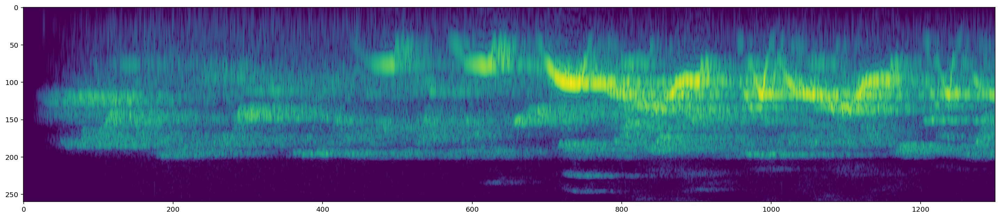

In [42]:
fig = plt.figure(figsize=(25,7))
plt.imshow(b['long_mel_spec'][:,0:260*5])
plt.show()

In [47]:
import IPython.display as ipd
x = np.load('/app/_data/npy/waves_npy/'+b['filename']+'.npy')
ipd.Audio(x, rate=32000) 

In [25]:
dict_nocall = {'/app/_data/train_short_audio/thbkin/XC282319.ogg': [0,520]}

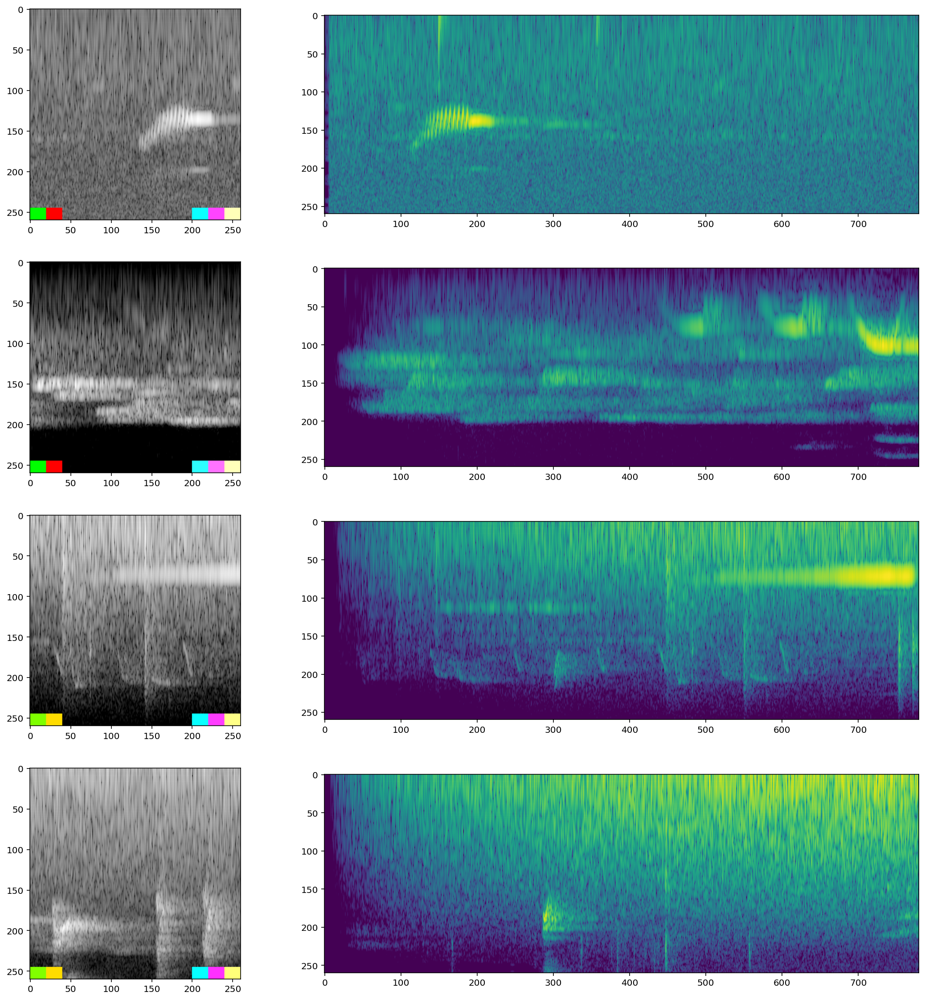

In [39]:
fig = plt.figure(figsize=(25,20))
gs = fig.add_gridspec(4, 4)
for i in range(0,4):
    b = gen._get_one(i)
    fig_1 = fig.add_subplot(gs[i, 1])
    fig_1.imshow(b['image'])
    fig_1 = fig.add_subplot(gs[i, 2: ])
    plt.imshow(b['long_mel_spec'][:,0:260*3])
plt.show();

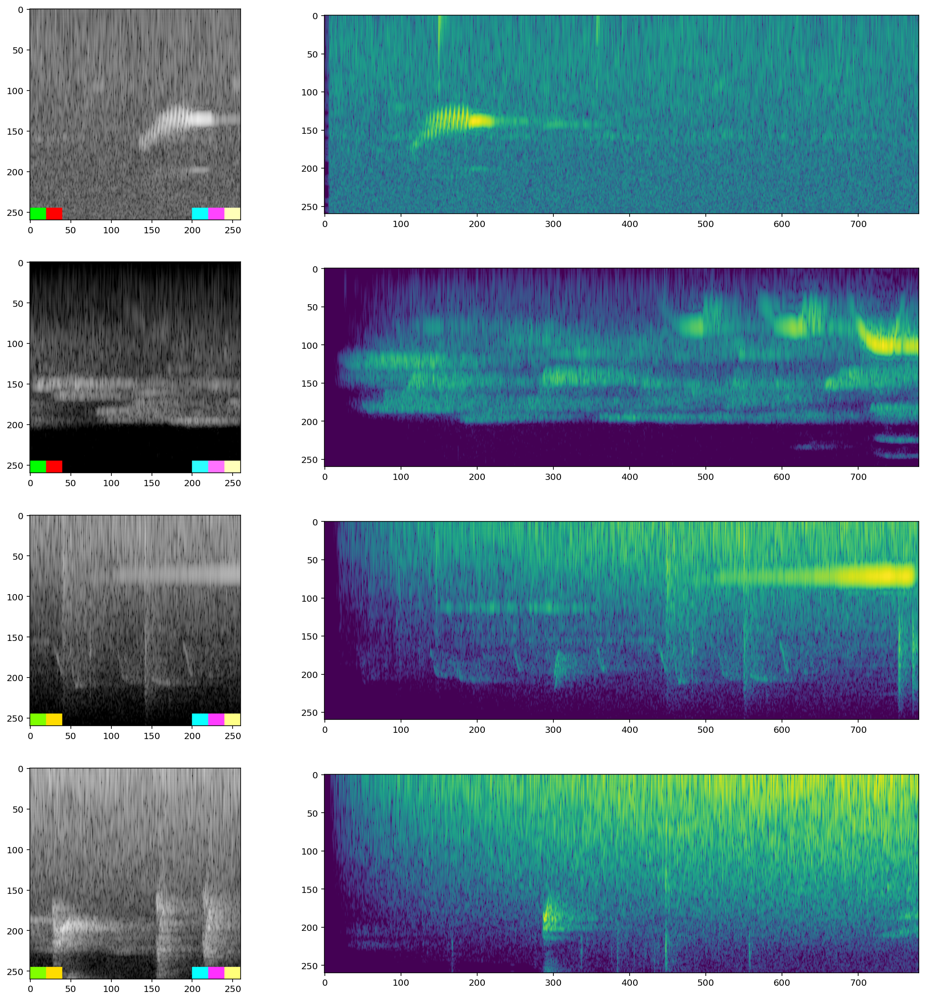

In [32]:
fig = plt.figure(figsize=(25,20))
gs = fig.add_gridspec(4, 4)
for i in range(0,4):
    b = gen._get_one(i)
    fig_1 = fig.add_subplot(gs[i, 1])
    fig_1.imshow(b['image'])
    fig_1 = fig.add_subplot(gs[i, 2: ])
    plt.imshow(b['long_mel_spec'][:,0:260*3])
plt.show();
